In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import cmasher as cmr

from astropy.io import fits
from astropy.coordinates import SkyCoord, match_coordinates_sky
import astropy.units as u
from PIL import Image

import os
from pathlib import Path
import requests
from tqdm.notebook import tqdm

ROOT = Path('../..').resolve()
results_dir = ROOT/'results/xSAGA-init'

In [2]:
c0 = '#003f5c'
c4 = '#ffa400'

# Clustering-based redshift tomography

Based on http://tomographer.org/ and relevant papers. I fed in the position for all galaxies (`a_cl`) and for only satellite candidates (`s_cl`).

In [237]:
a_cl = pd.read_csv(results_dir/'clustering-dNdz_init-all.csv')
s_cl = pd.read_csv(results_dir/'clustering-dNdz_init-sat.csv')

## All galaxies

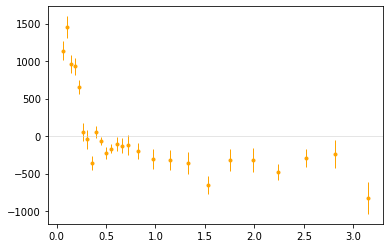

In [241]:
plt.errorbar(a_cl.z, a_cl.dNdz_b, a_cl.dNdz_b_err, c=c4, marker='.', ls='', lw=1)
plt.axhline(0, c='0.8', lw=0.5)

## Satellite candidates

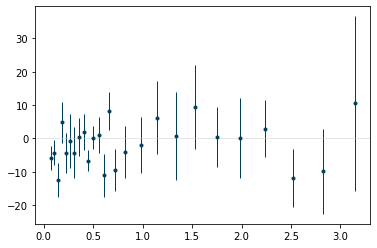

In [239]:
plt.errorbar(s_cl.z, s_cl.dNdz_b, s_cl.dNdz_b_err, c=c0, marker='.', ls='', lw=1)
plt.axhline(0, c='0.8', lw=0.5)

## Combined

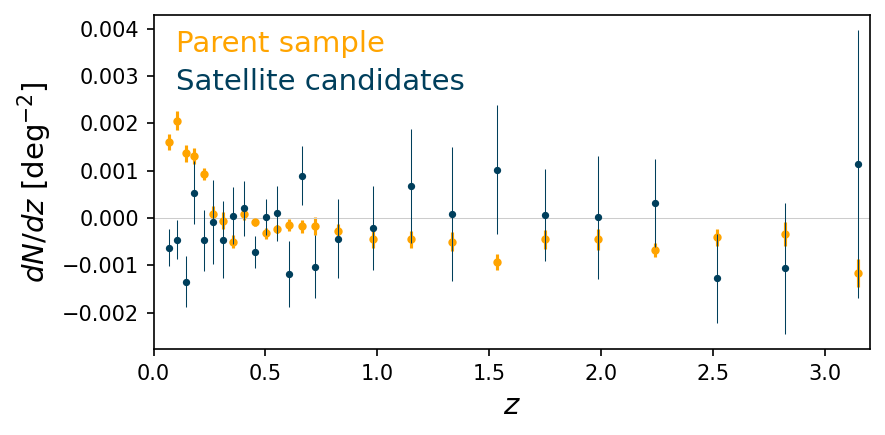

In [243]:
plt.figure(figsize=(6, 3), dpi=150)

plt.errorbar(s_cl.z, s_cl.dNdz_b/N_s, s_cl.dNdz_b_err/N_s, c=c0, marker='.', ls='', markersize=5, lw=0.5, alpha=1, zorder=6)
plt.errorbar(a_cl.z, a_cl.dNdz_b/N_a, a_cl.dNdz_b_err/N_a, c=c4, marker='.', ls='', lw=1.5, alpha=1)
plt.axhline(0, c='0.8', lw=0.5)

plt.xlim(0, 3.2)
plt.ylabel(r'$dN/dz$ [deg$^{-2}$]', fontsize=14)
plt.xlabel('$z$', fontsize=14)

plt.text(0.1, 0.0035, 'Parent sample', fontsize=14, color=c4)
plt.text(0.1, 0.0027, 'Satellite candidates', fontsize=14, color=c0)

plt.tight_layout()

# Dwarf galaxy structure

In [3]:
adf = pd.read_csv(ROOT/'results/predictions-initial.csv')
sdf = adf[adf.p_sat > 0.5]

N_a = len(adf)
N_s = len(sdf)

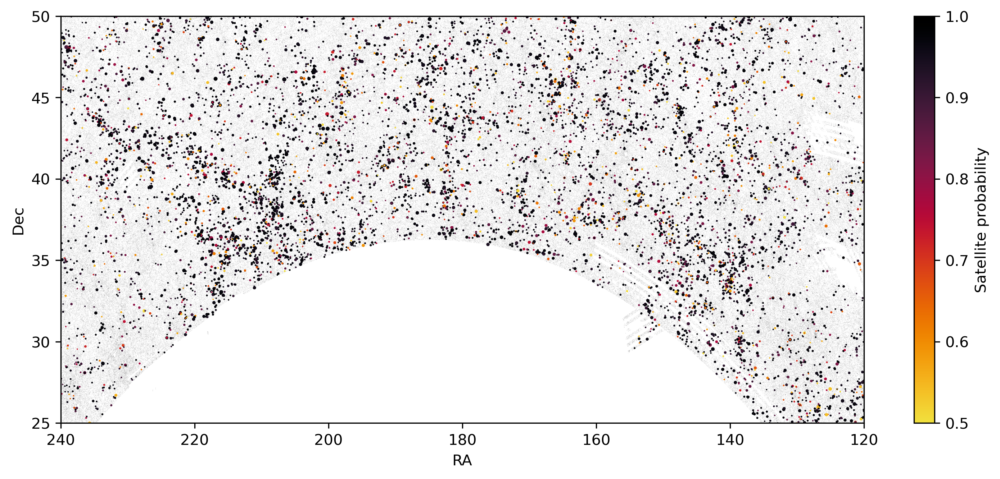

In [9]:
plt.figure(figsize=(12, 5), dpi=300)
plt.scatter(adf.ra, adf.dec, edgecolor='none', s=0.1, c='k', alpha=0.1)

sc = plt.scatter(sdf.ra, sdf.dec, c=sdf.p_sat, edgecolor='none', s=(sdf.r0/20)**-4, cmap='cmr.ember_r', vmin=0.5, vmax=1.)

plt.colorbar(sc, label='Satellite probability')

plt.xlim(240, 120)
plt.ylim(25, 50)

plt.xlabel('RA')
plt.ylabel('Dec');

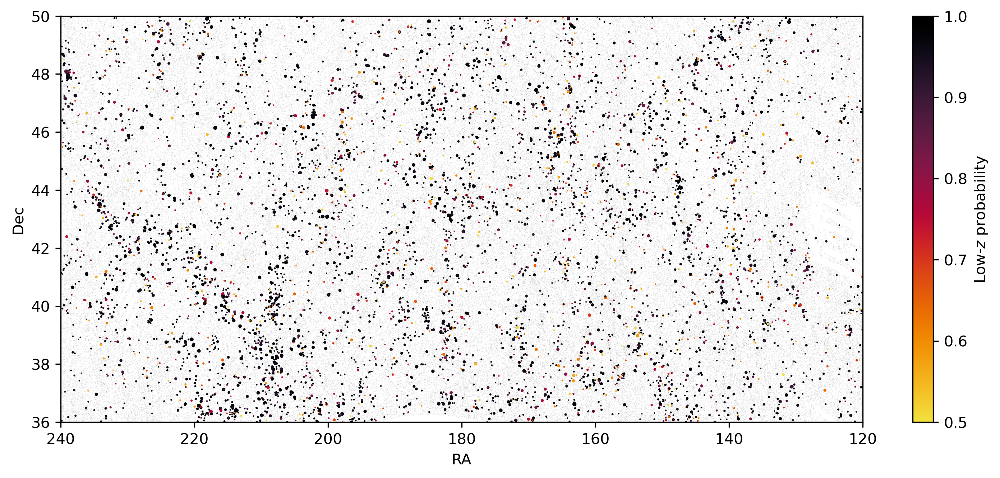

In [139]:
plt.figure(figsize=(12, 5), dpi=300)
plt.scatter(adf.ra, adf.dec, edgecolor='none', s=0.1, c='k', alpha=0.1)

sc = plt.scatter(sdf.ra, sdf.dec, c=sdf.p_sat, edgecolor='none', s=(sdf.r0/20)**-4, cmap='cmr.ember_r', vmin=0.5, vmax=1.)

plt.colorbar(sc, label='Low-$z$ probability')

plt.xlim(240, 120)
plt.ylim(36, 50)

plt.xlabel('RA')
plt.ylabel('Dec');

# Compare with known NSA galaxies

## Low-redshift ($z < 0.03$)

In [23]:
nsa = fits.getdata(ROOT/'data/nsa_v1_0_1.fits')
len(nsa)

641409

In [24]:
nsa.columns

ColDefs(
    name = 'IAUNAME'; format = '19A'
    name = 'SUBDIR'; format = '27A'
    name = 'RA'; format = 'D'
    name = 'DEC'; format = 'D'
    name = 'ISDSS'; format = 'J'
    name = 'INED'; format = 'J'
    name = 'ISIXDF'; format = 'J'
    name = 'IALFALFA'; format = 'J'
    name = 'IZCAT'; format = 'J'
    name = 'ITWODF'; format = 'J'
    name = 'MAG'; format = 'E'
    name = 'Z'; format = 'E'
    name = 'ZSRC'; format = '7A'
    name = 'SIZE'; format = 'E'
    name = 'RUN'; format = 'I'
    name = 'CAMCOL'; format = 'B'
    name = 'FIELD'; format = 'I'
    name = 'RERUN'; format = '3A'
    name = 'XPOS'; format = 'E'
    name = 'YPOS'; format = 'E'
    name = 'NSAID'; format = 'J'
    name = 'ZDIST'; format = 'E'
    name = 'SERSIC_NMGY'; format = '7E'
    name = 'SERSIC_NMGY_IVAR'; format = '7E'
    name = 'SERSIC_OK'; format = 'I'
    name = 'SERSIC_RNMGY'; format = '7E'
    name = 'SERSIC_ABSMAG'; format = '7E'
    name = 'SERSIC_AMIVAR'; format = '7E'
    name = 'EXTINCTIO

In [5]:
nsa_z = nsa.Z
nsa_ra = nsa.RA
nsa_dec = nsa.DEC
nsa_mag = nsa.ELPETRO_ABSMAG[:, 4]

In [6]:
nsa_lowz = nsa_z < 0.03
sum(nsa_lowz)

50854

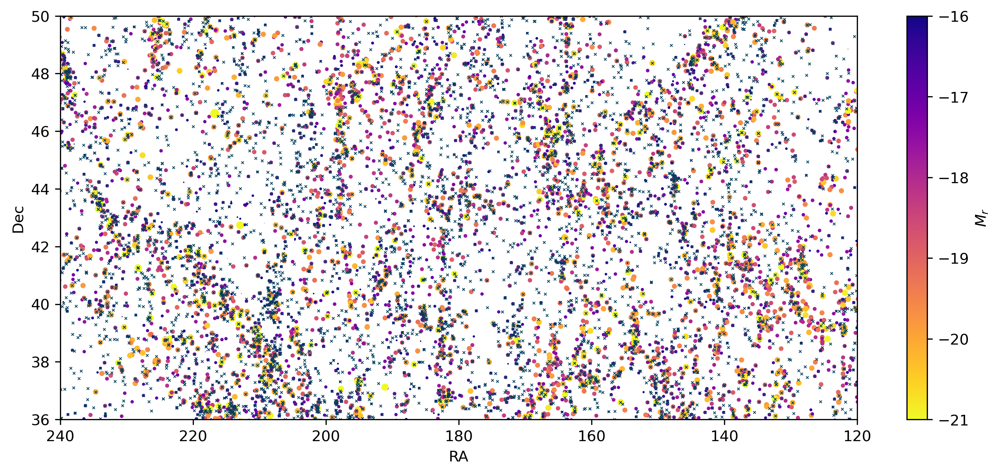

In [143]:
plt.figure(figsize=(12, 5), dpi=300)

sc = plt.scatter(nsa_ra[nsa_lowz], nsa_dec[nsa_lowz], c=nsa_mag[nsa_lowz], edgecolor='none', s=(nsa_mag[nsa_lowz]/13)**6, cmap='plasma_r', vmin=-21, vmax=-16)
plt.colorbar(sc, label='$M_{r}$')

plt.scatter(sdf.ra, sdf.dec, marker='x', lw=0.5, c=c0, edgecolor='none', s=3)

plt.xlim(240, 120)
plt.ylim(36, 50)       # only look at high lattitudes to remove the survey boundary

plt.xlabel('RA')
plt.ylabel('Dec');

## Crossmatch low-z candidates with confirmed catalogs

In [7]:
nsa_coords_lowz = SkyCoord(nsa_ra[nsa_lowz], nsa_dec[nsa_lowz], unit='deg')
sat_coords = SkyCoord(sdf.ra, sdf.dec, unit='deg')

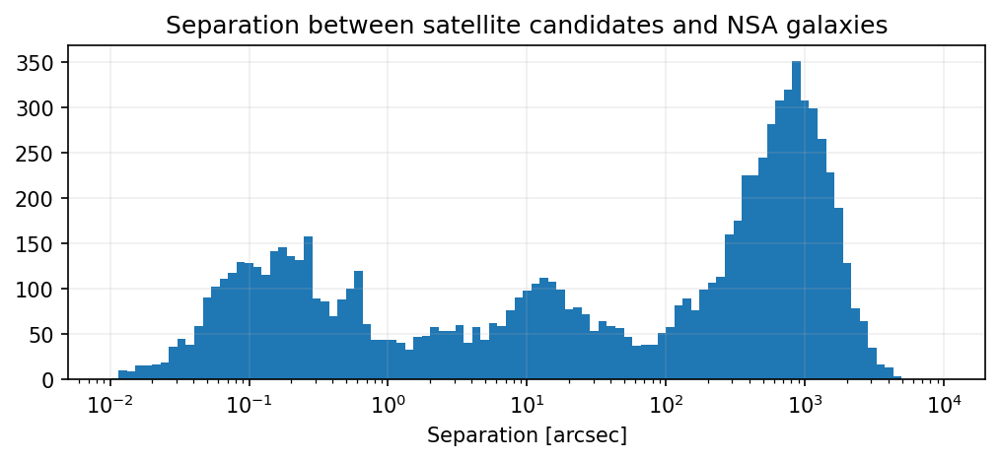

In [8]:
nsa_idx, sep, _ = sat_coords.match_to_catalog_sky(nsa_coords_lowz)
sep = sep.to('arcsec').value

plt.figure(figsize=(8,3), dpi=150)
plt.hist(sep, bins=np.logspace(-2, 4, num=100))
plt.xscale('log')
plt.xlabel('Separation [arcsec]')
plt.title('Separation between satellite candidates and NSA galaxies')
plt.grid(alpha=0.2);

In [9]:
from astropy.cosmology import FlatLambdaCDM
import astropy.units as u

c = FlatLambdaCDM(H0=70, Om0=0.3)
c.angular_diameter_distance(0.03) / (u.radian).to(u.arcsec)

<Quantity 0.00060065 Mpc>

Based on this, 1 arcsec seems like a good separation for matches. The peak is around 0.1 arcsec, which makes sense, but then around 10 arcsec we are likely ~~matching with random $z \sim 0.2$ backgrounds~~ finding bright galaxies that have been shredded into multiple artifacts, and then at 1000 arcsec we are probably matching with the nearest $L^*$ galaxy (host?).

Note also that 1000 arcsec equals 200 projected kpc at $z = 0.01$, 400 pkpc at $z = 0.02$, and so on.

Let's remove all the shredded things and self-matches using a cut of > 60 arcsec.

In [19]:
len(nsa_idx), len(np.unique(nsa_idx)), len(np.unique(nsa_idx[sep>60]))

(9231, 5149, 3070)

There are duplicate matches to NSA spec-$z$ confirmed gaalxies, i.e., we are definitely tracing multiple dwarfs around the same host. (And probably a small number of large nearby galaxies that were accidentally split into multiple images.)

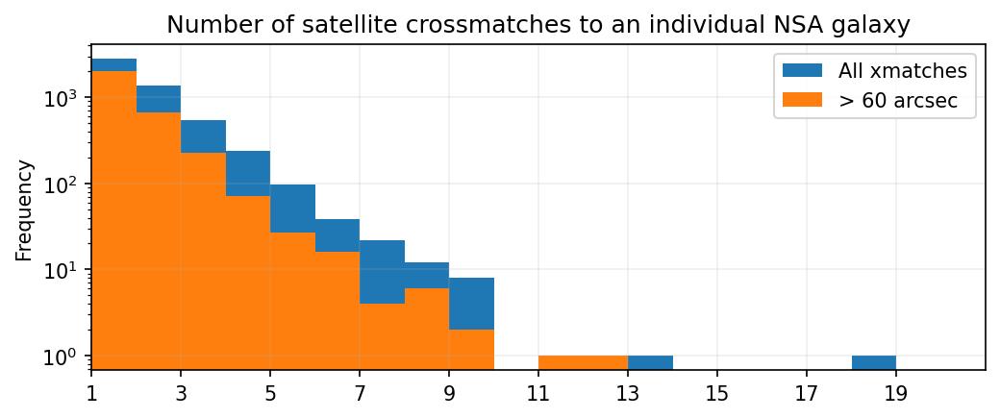

In [21]:
plt.figure(figsize=(8,3), dpi=150)
pd.Series(nsa_idx).value_counts().plot.hist(bins=20, range=(1,21), log=True, label='All xmatches')
pd.Series(nsa_idx[sep>60]).value_counts().plot.hist(bins=20, range=(1,21), log=True, label='> 60 arcsec')

plt.xlim(1, 21);
plt.xticks(np.arange(1, 21, 2))
plt.title('Number of satellite crossmatches to an individual NSA galaxy')
plt.legend()
plt.grid(alpha=0.2)

Now add this to new dataframe and save results

In [10]:
sat_x_nsa = sdf.copy()

sat_x_nsa['z_NSA'] = nsa_z[nsa_lowz][nsa_idx]
sat_x_nsa['M_r_NSA'] = nsa_mag[nsa_lowz][nsa_idx]
sat_x_nsa['sep_NSA'] = sep
sat_x_nsa['ra_NSA'] = nsa_ra[nsa_lowz][nsa_idx]
sat_x_nsa['dec_NSA'] = nsa_dec[nsa_lowz][nsa_idx]

sat_x_nsa.sample(10, random_state=42)

,objID,ra,dec,g0,r0,R_eff,p_sat,z_NSA,M_r_NSA,sep_NSA,ra_NSA,dec_NSA
88801,1237661871873523796,206.144734,42.169513,15.97209,15.55049,7.463689,0.979012,0.008980,-17.049103,0.195894,206.144801,42.169491
76094,1237664836467752982,137.020787,27.249905,14.97184,14.30392,9.088293,0.850783,0.021213,-19.879108,0.058900,137.020805,27.249903
706796,1237657400272420901,140.762873,44.554925,14.14448,13.52396,11.194550,0.977518,0.008867,-18.317438,0.389631,140.762738,44.554875
66148,1237662662670352906,216.320764,35.445465,20.16625,19.86662,2.789183,0.577062,0.028939,-18.040775,129.355783,216.288293,35.421152
653032,1237664818211717387,177.310352,36.762467,17.56329,17.30067,5.012787,0.525583,0.021963,-16.924253,0.406902,177.310426,36.762371
141071,1237664819828686982,195.494126,37.795033,16.09628,15.76636,3.922620,0.787859,0.027160,-17.405298,1156.676822,195.895135,37.742602
5635,1237664819823968342,181.820026,38.228409,20.38511,19.96255,2.363419,0.973367,0.023315,-18.049170,1210.385038,182.239825,38.294680
354869,1237662302971363676,213.994163,49.571121,17.93726,17.65908,5.765962,0.973230,0.026502,-19.071884,526.046360,214.212338,49.534807
46482,1237661361296507105,197.388663,46.488094,18.56639,18.15312,3.236506,0.894157,0.024556,-18.911005,739.759848,197.114483,46.569601
555630,1237662226224382000,212.508784,37.550969,14.86998,14.37513,6.858524,0.944627,0.026304,-20.311653,0.185679,212.508837,37.550940


In [161]:
# sat_x_nsa.to_csv(results_dir/'sat_x_NSA.csv', index=False)

## Sanity checks with outliers

For the matches, we would hope that the r magnitudes are similar to the ones derived in NSA? (Using the redshift)

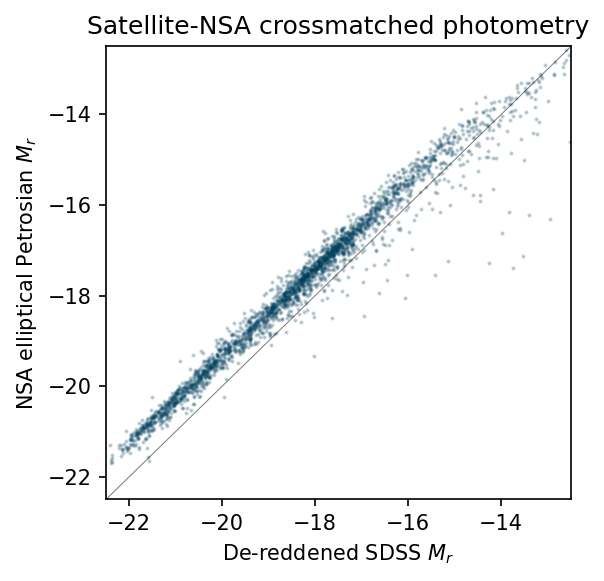

In [242]:
sat_matches = sat_x_nsa[(sat_x_nsa.sep_NSA < 1.) & (sat_x_nsa.z_NSA > 0)]

D_L = 3e5 / 70 * sat_matches.z_NSA # u.Mpc
M_r0 = sat_matches.r0 - 5*np.log10(D_L) - 25

plt.figure(figsize=(4, 4), dpi=150)
plt.scatter(M_r0, sat_matches.M_r_NSA, s=1, alpha=0.2, c=c0)
plt.xlim(-22.5, -12.5)
plt.ylim(-22.5, -12.5)

plt.plot(plt.xlim(), plt.ylim(), c='k', alpha=0.5, lw=0.5)

plt.title('Satellite-NSA crossmatched photometry')
plt.xlabel('De-reddened SDSS $M_r$')
plt.ylabel('NSA elliptical Petrosian $M_r$');

That's basically fine, since obviously 3e5 is not exactly the speed of light and 70 is not $H_0$ in the appropriate units. However, there are a number of catastrophic outliers -- nearly all of which are below the 1-to-1 line. Let's see what's going on with them.

In [169]:
outlier_idx = (M_r0 > sat_matches.M_r_NSA).values

outliers = sat_matches.iloc[outlier_idx].copy()
outliers['M_r0'] = M_r0[outlier_idx]
outliers

,objID,ra,dec,g0,r0,R_eff,p_sat,z_NSA,M_r_NSA,sep_NSA,ra_NSA,dec_NSA,M_r0
58,1237658611977683171,158.800296,46.236739,16.74269,16.63662,4.760215,0.973725,0.001683,-13.112530,0.156747,158.800279,46.236697,-12.653581
593,1237664869748637938,138.301548,33.443336,18.00061,17.79888,4.646336,0.970868,0.006076,-14.945798,0.149459,138.301557,33.443377,-14.279203
7235,1237657630592008449,146.763614,46.812000,17.38516,17.01059,8.528247,0.968619,0.015679,-17.165758,0.330489,146.763748,46.812001,-17.126138
14203,1237662224605577257,188.469724,39.625920,16.16529,16.03928,9.100364,0.979062,0.002162,-14.841435,0.291300,188.469823,39.625893,-13.794735
32762,1237661358620082187,191.597260,48.235201,15.43472,15.32081,6.551143,0.976830,0.003001,-15.429116,0.272905,191.597200,48.235266,-15.225443
...,...,...,...,...,...,...,...,...,...,...,...,...,...
697597,1237658205590650886,203.925059,49.176416,16.62436,16.47404,9.062361,0.958352,0.002113,-14.406600,0.206881,203.924993,49.176454,-13.310446
700314,1237662224599547996,170.891824,38.726197,16.74217,16.09935,6.944490,0.976375,0.007183,-16.769279,0.246076,170.891768,38.726145,-16.342442
701127,1237661435393999250,222.689923,41.628449,17.74219,17.35710,7.431412,0.975996,0.008411,-15.720649,0.465236,222.689750,41.628462,-15.427258
701922,1237661358615035950,174.433763,47.893119,12.58321,12.01429,17.561010,0.979147,0.002392,-18.392923,0.232750,174.433689,47.893077,-18.039935


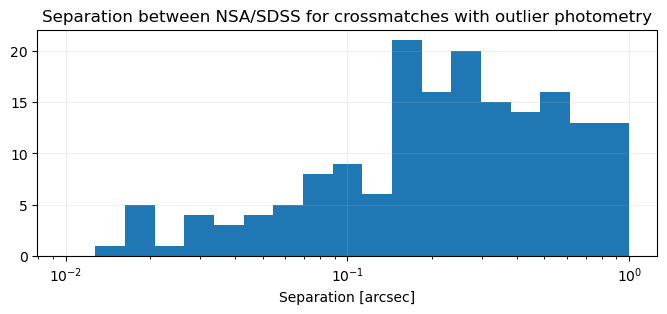

In [147]:
plt.figure(figsize=(8,3), dpi=100)
plt.hist(outliers.sep_NSA, bins=np.logspace(-2, 0, num=20))
plt.xscale('log')
plt.xlabel('Separation [arcsec]')
plt.title('Separation between NSA/SDSS for crossmatches with outlier photometry')
plt.grid(alpha=0.2);

Perhaps these have bright or weird background sources? Not super illuminating, so let's visualize a few. 

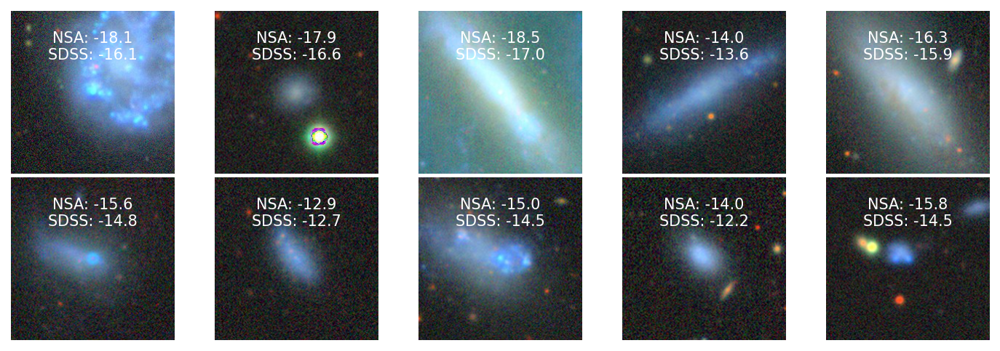

In [167]:
fig, axes = plt.subplots(2, 5, figsize=(12, 4), dpi=150)

for row, ax in zip(outliers.sample(10, random_state=12).itertuples(), axes.flat):
    url = (
        "http://legacysurvey.org/viewer/cutout.jpg"
        f"?ra={row.ra}"
        f"&dec={row.dec}"
        "&layer=dr8"
        "&size=224"
    )
    
    response = requests.get(url, stream=True)
    img = Image.open(response.raw)
    
    ax.imshow(img)
    ax.text(0.5, 0.7, f'NSA: {row.M_r_NSA:.1f}\n' f'SDSS: {row.M_r0:.1f}', color='white', ha='center', transform=ax.transAxes)
    ax.axis('off')
    ax.set_aspect('equal')
    
fig.subplots_adjust(wspace=0.02, hspace=0.02)

Typical RA/Dec offsets for crossmatched *outliers*

In [171]:
outliers.ra - outliers.ra_NSA

58        0.000017
593      -0.000009
7235     -0.000134
14203    -0.000099
32762     0.000061
            ...   
697597    0.000066
700314    0.000056
701127    0.000172
701922    0.000074
706476    0.000032
Length: 174, dtype: float64

Text(0, 0.5, '$\\Delta$ Dec [arcsec]')

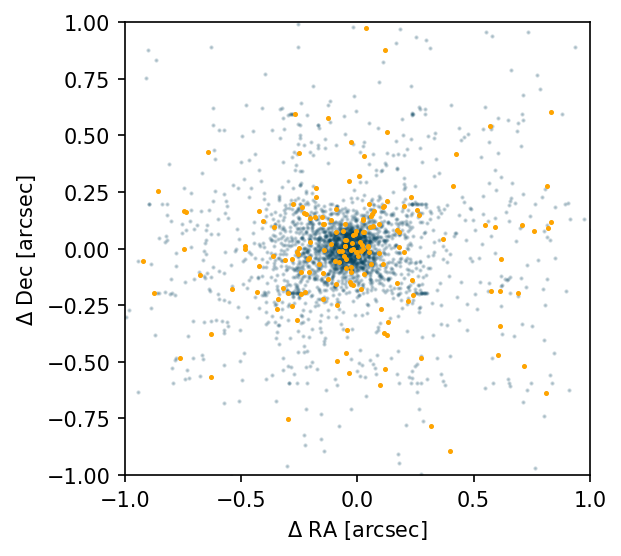

In [194]:
plt.figure(figsize=(4, 4), dpi=150)
plt.scatter(3600*(sat_x_nsa.ra - sat_x_nsa.ra_NSA), 3600*(sat_x_nsa.dec - sat_x_nsa.dec_NSA), c=c0, alpha=0.2, s=1)

plt.scatter(3600*(outliers.ra - outliers.ra_NSA), 3600*(outliers.dec - outliers.dec_NSA), c=c4, s=2)
plt.xlim(-1, 1)
plt.ylim(-1, 1)

plt.xlabel(r'$\Delta$ RA [arcsec]')
plt.ylabel(r'$\Delta$ Dec [arcsec]')

## LSS of crossmatches

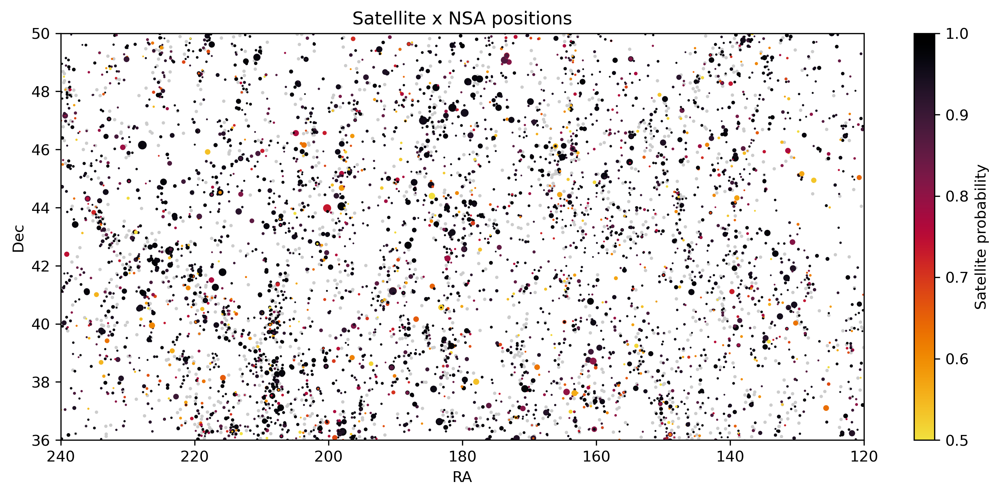

In [241]:
plt.figure(figsize=(12, 5), dpi=300)

xmatch = (sat_x_nsa.sep_NSA < 1.).values
plt.scatter(sat_x_nsa[xmatch].ra, sat_x_nsa[xmatch].dec, c='0.8', edgecolor='none', s=5)

sc = plt.scatter(sat_x_nsa[~xmatch].ra, sat_x_nsa[~xmatch].dec, c=sat_x_nsa[~xmatch].p_sat, edgecolor='none', s=(sat_x_nsa[~xmatch].r0/22)**-6, cmap='cmr.ember_r', vmin=0.5, vmax=1.)
plt.colorbar(sc, label='Satellite probability')

plt.xlim(240, 120)
plt.ylim(36, 50)       


plt.title('Satellite x NSA positions')
plt.xlabel('RA')
plt.ylabel('Dec');

# Configurations ofsatellites around an expanded sample of MW analogs: $-20 > M_r > -21$

In [245]:
# xmatch = (sat_x_nsa.sep_NSA < 1.)

# MW_like = (sat_x_nsa.M_r_NSA > -21) & (sat_x_nsa.M_r_NSA < -20) & xmatch
# sum(MW_like)

313

Note: I was using `sat_x_nsa` but I should just use `nsa` outright to identify hosts!!!

In [11]:
sat_x_nsa = pd.read_csv(results_dir/'sat_x_NSA.csv')

In [30]:
def load_NSA():
    """Returns dataframe with some NSA info.
    """
    nsa = fits.getdata(ROOT/'data/nsa_v1_0_1.fits')

    # do this column by column, *not* on entire catalog
    byteorder = lambda x: x.byteswap().newbyteorder()

    # doesn't use .byteswap().newbyteorder() because that's super slow...
    return pd.DataFrame({
        'NSAID': byteorder(nsa.NSAID),
        'z_NSA': byteorder(nsa.Z),
        'ra_NSA': byteorder(nsa.RA),
        'dec_NSA': byteorder(nsa.DEC),
        'M_r_NSA': byteorder(nsa.ELPETRO_ABSMAG[:, 4]),
        'mass_NSA': byteorder(nsa.ELPETRO_MASS)
    })

nsa = load_NSA()

In [29]:
MW_like = (nsa.M_r_NSA > -21) & (nsa.M_r_NSA < -20) & (nsa.z_NSA < 0.03)
sum(MW_like)

842

If they're not within 1deg of a satellite then forget it

In [27]:
nsa = nsa[MW_like].copy()

nsa_coords = SkyCoord(nsa.ra_NSA, nsa.dec_NSA, unit='deg')

sat_idx, sep, _ = nsa_coords.match_to_catalog_sky(sat_coords)

# within 1 deg of a sat
nsa = nsa[sep < 1*u.deg].copy()
len(nsa)

842

## New satellites

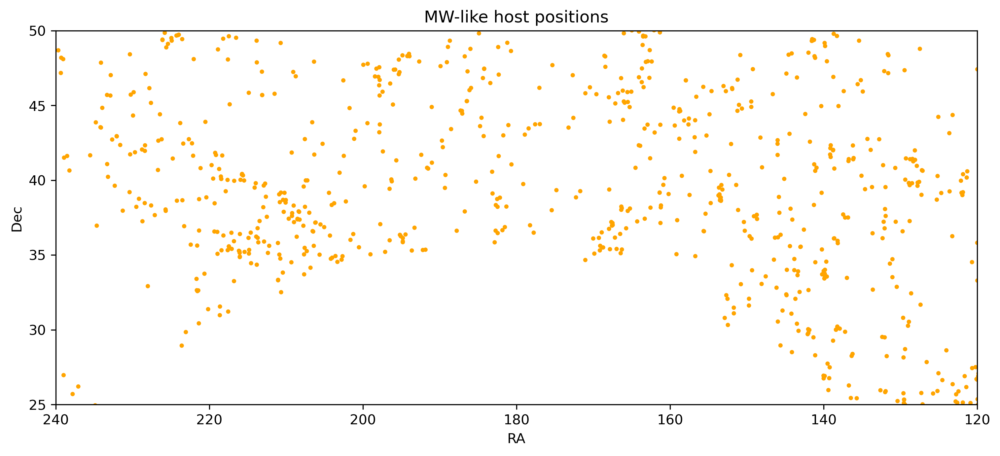

In [28]:
plt.figure(figsize=(12, 5), dpi=300)

plt.scatter(nsa.ra_NSA, nsa.dec_NSA, c=c4, edgecolor='none', s=10)

plt.xlim(240, 120)
plt.ylim(25, 50)       

plt.title('MW-like host positions')
plt.xlabel('RA')
plt.ylabel('Dec');

New satellites that *don't* have NSA redshifts

In [15]:
hosts = nsa.set_index('NSAID').copy()
host_coords = SkyCoord(hosts.ra_NSA, hosts.dec_NSA, unit='deg')

xmatch = (sat_x_nsa.sep_NSA < 1.)

new_sats = sat_x_nsa[~xmatch].copy()
new_sat_coords = SkyCoord(new_sats.ra, new_sats.dec, unit='deg')

host_idx, host_sep, _ = new_sat_coords.match_to_catalog_sky(host_coords)
host_sep = host_sep.to('arcsec').value

len(new_sats), len(hosts)

(6615, 842)

4871 satellites < 1 degree; remove 185 at < 1 arcmin.

The > 1 arcmin crit ensures that they aren't shredded host galaxies.

In [16]:
new_sats['host_nsaid'] = hosts.iloc[host_idx].index.values
new_sats['host_sep'] = host_sep

# only keep those with hosts that are < 1 degree *and* > 1 arcmin
new_sats = new_sats[(new_sats.host_sep < 3600) & (new_sats.host_sep > 60)].copy()
len(new_sats)

4586

In [17]:
grouped = new_sats.groupby('host_nsaid')

# iterate through the groups, one host at a time
host_nsaID, group = next(iter(grouped))

# disregard all columns ending with `_NSA` because the separations are at least 1 arcsec
print(f'Host ID = {host_nsaID} located at RA Dec = {hosts.loc[host_nsaID].ra_NSA:.6f} {hosts.loc[host_nsaID].dec_NSA:.6f}')
display(group)

Host ID = 47898 located at RA Dec = 123.197921 44.357359


,objID,ra,dec,g0,r0,R_eff,p_sat,sep_NSA,NSAID,z_NSA,ra_NSA,dec_NSA,M_r_NSA,host_nsaid,host_sep
4271,1237651250945327463,123.077517,45.249703,19.19997,18.79228,2.789752,0.974629,1052.253320,48086,0.023345,122.784214,45.456953,-17.334787,47898,3227.127769
5876,1237654392179327488,123.700284,44.470086,19.85411,19.38105,1.912438,0.933046,288.834483,47883,0.023599,123.662048,44.394643,-18.763628,47898,1354.065837


By using Yao's image list tool and copy+pasting the host and satellite RA/Dec, we can look at these... many do look like satellites (aside from the super nearby diffuse spiral galaxy, which is probably truly in the foreground, and the bright galaxy + host which were clipped into multiple sources)

## Old satellites (known sats, with NSA redshifts and small separations)

In [43]:
old_sats = sat_x_nsa[xmatch].copy()
old_sat_coords = SkyCoord(old_sats.ra, old_sats.dec, unit='deg')

host_idx, host_sep, _ = old_sat_coords.match_to_catalog_sky(host_coords)
host_sep = host_sep.to('arcsec').value

len(old_sats), len(hosts)

(2616, 842)

2058 -> 1734 after (>1arcmin cut)

In [44]:
old_sats['host_nsaid'] = hosts.iloc[host_idx].index.values
old_sats['host_sep'] = host_sep

# only keep those with hosts that are < 1 degree
old_sats = old_sats[(old_sats.host_sep < 3600) & (old_sats.host_sep > 60)].copy()
len(old_sats)

1734

In [45]:
grouped = old_sats.groupby('host_nsaid')
host_nsaID, group = next(iter(grouped))
print(f'Host ID = {host_nsaID} located at RA Dec = {hosts.loc[host_nsaID].ra_NSA:.6f} {hosts.loc[host_nsaID].dec_NSA:.6f}')
display(group)

Host ID = 47898 located at RA Dec = 123.197921 44.357359


,objID,ra,dec,g0,r0,R_eff,p_sat,sep_NSA,NSAID,z_NSA,ra_NSA,dec_NSA,M_r_NSA,host_nsaid,host_sep
1329,1237654392179261669,123.601084,44.390974,18.08631,17.68751,2.812383,0.961376,0.280009,47888,0.024009,123.601161,44.391029,-16.76464,47898,1044.466721


## Summary

An examination of [UGC 4436](http://simbad.u-strasbg.fr/simbad/sim-id?Ident=%40492961&Name=UGC%20%204436&submit=submit) (objID 1237651250947293406) as a host gave some nice insights. See in [Legacy viewer](https://www.legacysurvey.org/viewer?ra=127.459652&dec=48.781015&zoom=14&layer=ls-dr9). Out of 15 total satellites classified by the CNN, we find **4 known satellites**, **4 duplicate bright galaxies**, and perhaps **5(?) nice-looking candidates**.

For the current NSAID = 47898, we find 3 satellites (1 old, 2 new), all of which look quite plausible.

It probably makes sense to simply combine all satellites into the same catalog, since we can later distinguish which ones have NSA crossmatches (using the `sep_NSA` column). Let's do this now

## All satellite candidates grouped by host - save in `results/xSAGA-init/groupby-host/`

In [18]:
host_idx, host_sep, _ = sat_coords.match_to_catalog_sky(host_coords)
host_sep = host_sep.to('arcsec').value

all_sats = sat_x_nsa.copy() # all satellites including non-matches

all_sats['host_nsaid'] = hosts.iloc[host_idx].index.values
all_sats['host_sep'] = host_sep

all_sats = all_sats[(all_sats.host_sep < 3600) & (all_sats.host_sep > 60)].copy()
len(all_sats)

6320

In [19]:
# verify that we get all 15 satellite candidates
grouped = all_sats.groupby('host_nsaid')

host_objID, group = next(iter(grouped))

print(f'Host ID = {host_nsaID} located at RA Dec = {hosts.loc[host_nsaID].ra_NSA:.6f} {hosts.loc[host_nsaID].dec_NSA:.6f}')
display(group)

Host ID = 47898 located at RA Dec = 123.197921 44.357359


,objID,ra,dec,g0,r0,R_eff,p_sat,sep_NSA,NSAID,z_NSA,ra_NSA,dec_NSA,M_r_NSA,host_nsaid,host_sep
1329,1237654392179261669,123.601084,44.390974,18.08631,17.68751,2.812383,0.961376,0.280009,47888,0.024009,123.601161,44.391029,-16.764640,47898,1044.466721
4271,1237651250945327463,123.077517,45.249703,19.19997,18.79228,2.789752,0.974629,1052.253320,48086,0.023345,122.784214,45.456953,-17.334787,47898,3227.127769
5876,1237654392179327488,123.700284,44.470086,19.85411,19.38105,1.912438,0.933046,288.834483,47883,0.023599,123.662048,44.394643,-18.763628,47898,1354.065837


In [51]:
for host_objID, group in tqdm(grouped):
    group.to_csv(results_dir/f'groupby-NSA-host_-21_-20/{host_objID}.csv', index=False)

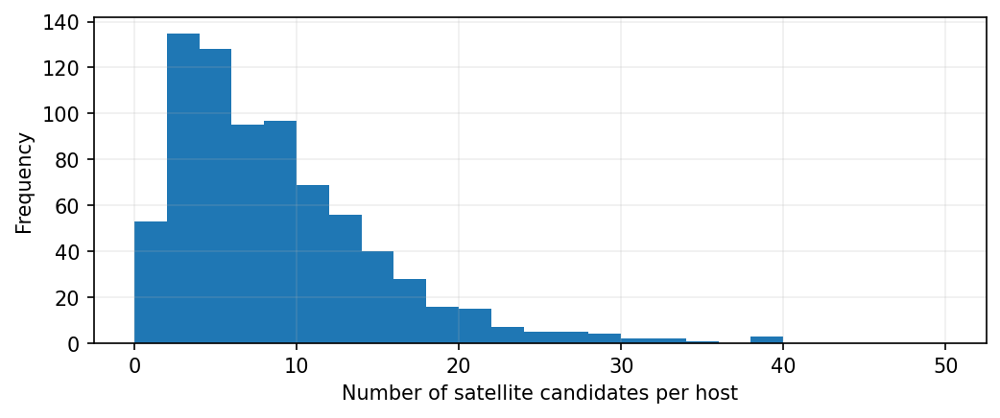

In [49]:
plt.figure(figsize=(8, 3), dpi=150)
grouped.size().plot.hist(bins=25, range=[0, 50])
plt.xlabel('Number of satellite candidates per host')
plt.grid(alpha=0.2)

# Host and satellite properties

Look at these:

    $wc -l groupby-NSA-host_-21_-20/*.csv | sort -nr | head
       7082 total
         52 631738.csv
         39 630351.csv
         39 629934.csv
         39 318999.csv
         36 628166.csv
         33 629941.csv
         33 297531.csv
         32 623242.csv
         31 630620.csv

    wc -l *.csv | shuf -n 5
          6 393803.csv
          4 128835.csv
          7 276547.csv
         13 316124.csv
          6 230847.csv


## Remove duplicate sources for each catalog

In [20]:
def remove_duplicates(sats_in_host, duplicate_sep=1*u.arcmin):
    """Given dataframe `sats_in_host`, removes all sources that are
    within `duplicate_sep` from each other, except the brightest one.
    """
    
    coords = SkyCoord(sats_in_host[['ra', 'dec']].values, unit='deg')
    idx_i, idx_j, sep, _ = coords.search_around_sky(coords, duplicate_sep)

    fainter_ids = []
    for i, j, s in zip(idx_i, idx_j, sep):
        if i != j:
            fainter_ids.append(
                np.where(
                    sats_in_host.r0.iloc[i] > sats_in_host.r0.iloc[j], 
                    sats_in_host.objID.iloc[i],
                    sats_in_host.objID.iloc[j]
                )
            )

    fainter_ids = np.unique(fainter_ids)
    return sats_in_host.set_index('objID').drop(fainter_ids).copy()


In [126]:
grouped = all_sats.groupby('host_nsaid')

for host_objID, group in tqdm(grouped):
    sats_in_host = remove_duplicates(group)
    
    # double check that no satellites are within 1 arcmin of host
    sats_in_host = sats_in_host[sats_in_host.host_sep > 60]
    
    sats_in_host.to_csv(results_dir/f'groupby-NSA-host_-21_-20/{host_objID}.csv')

In [128]:
sats_in_host

,objID,ra,dec,g0,r0,R_eff,p_sat,sep_NSA,NSAID,z_NSA,ra_NSA,dec_NSA,M_r_NSA,host_nsaid,host_sep
0,1237662305650212895,207.879522,39.454712,16.39956,16.05478,3.412949,0.974149,0.274219,275903,0.006047,207.879592,39.454765,-15.536840,630701,636.641408
1,1237662305650147710,207.672250,39.368145,19.47679,19.13684,2.714266,0.973708,276.703913,275899,0.008732,207.771666,39.369065,-16.031494,630701,751.987586
2,1237662306187346080,208.909189,39.716249,15.83316,15.48683,10.181630,0.974095,2.399186,678411,0.005717,208.909781,39.715763,-16.164562,630701,3359.348402
3,1237662193997316257,208.095918,39.687294,13.15989,12.46005,12.055490,0.975088,0.085686,592425,0.007089,208.095945,39.687305,-19.131773,630701,1140.650580
4,1237662194534253176,208.380104,40.030721,19.55363,18.92459,3.400284,0.607005,408.180646,275995,0.008764,208.515670,39.985184,-17.745811,630701,2472.813685
5,1237662194534383717,208.727768,39.977493,16.67173,16.22098,9.775283,0.977159,4.288535,276013,0.006995,208.729311,39.977344,-15.921434,630701,3163.901994
6,1237662193997185052,207.680657,39.706760,14.29250,13.51540,13.247230,0.954383,0.082482,275515,0.008475,207.680685,39.706768,-18.657438,630701,482.433663
7,1237662306724216889,208.865563,39.979813,17.65356,17.07427,4.883802,0.979937,1.154532,276014,0.006411,208.865922,39.979978,-14.610309,630701,3510.538400
8,1237662306187084495,208.041103,39.802521,20.24261,19.59302,3.308083,0.953043,441.686063,592425,0.007089,208.095945,39.687305,-19.131773,630701,1227.424593
9,1237662193997381867,208.257887,39.580780,14.26157,13.71991,15.311440,0.970777,0.126116,275857,0.008344,208.257914,39.580808,-18.588465,630701,1516.790999


Host NSAID 604842 (3 sats)
RA, Dec = 222.66440, 42.74087
z = 0.018234


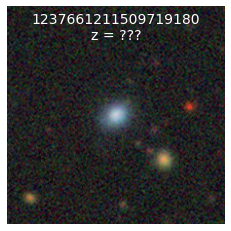

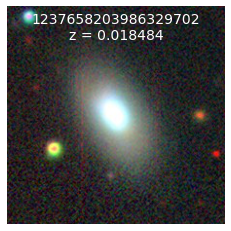

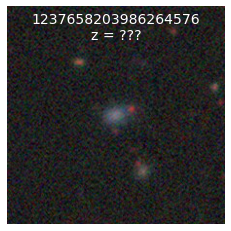

Host NSAID 422659 (7 sats)
RA, Dec = 204.00189, 34.81796
z = 0.024585


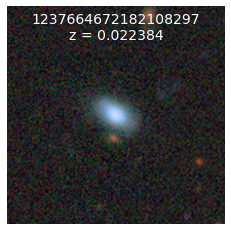

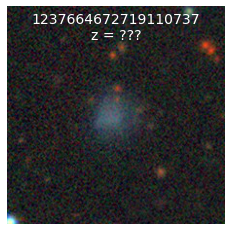

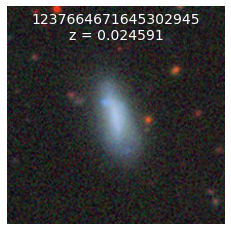

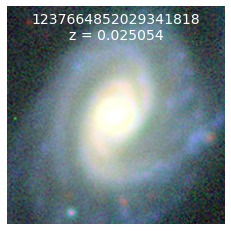

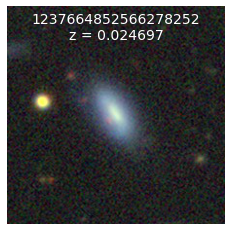

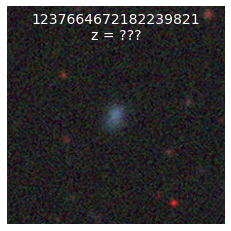

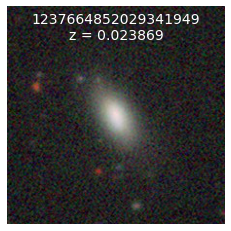

Host NSAID 272662 (14 sats)
RA, Dec = 178.41657, 43.46096
z = 0.019690


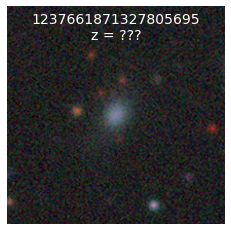

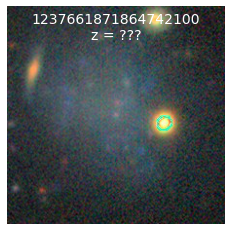

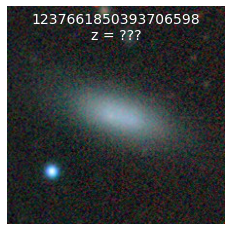

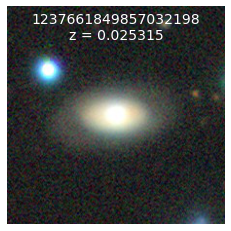

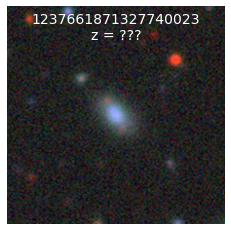

...

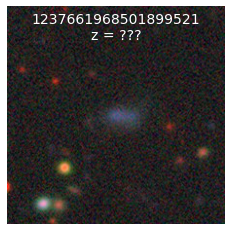

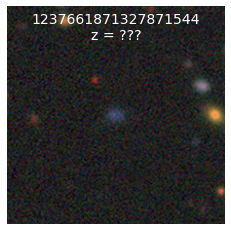

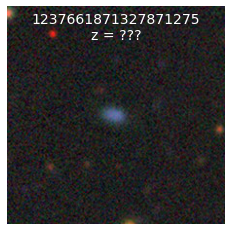

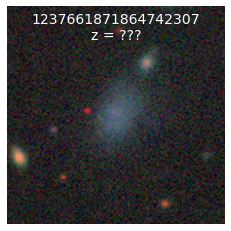

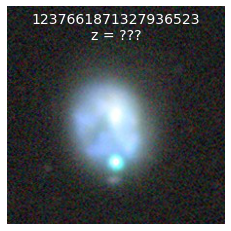

Host NSAID 183336 (6 sats)
RA, Dec = 162.68808, 46.84233
z = 0.024913


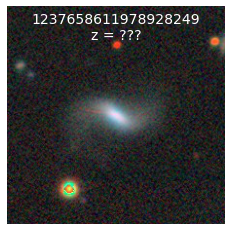

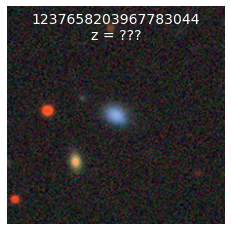

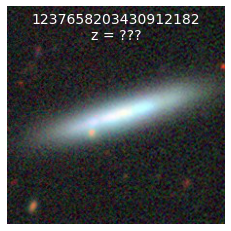

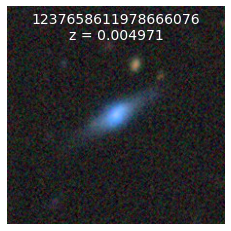

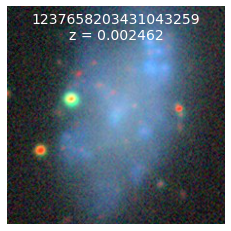

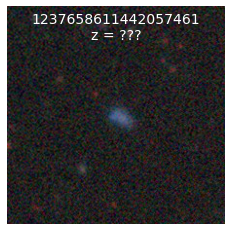

Host NSAID 276483 (3 sats)
RA, Dec = 212.97272, 38.19383
z = 0.020447


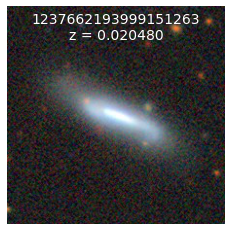

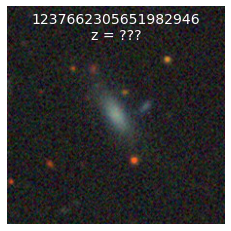

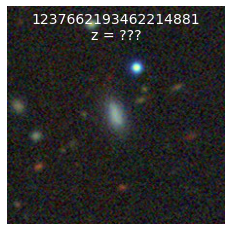

Host NSAID 437905 (1 sats)
RA, Dec = 196.29466, 40.04970
z = 0.027159


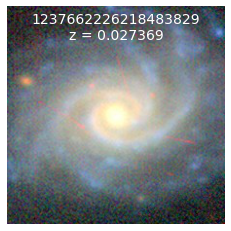

Host NSAID 407998 (5 sats)
RA, Dec = 130.36776, 25.23445
z = 0.029184


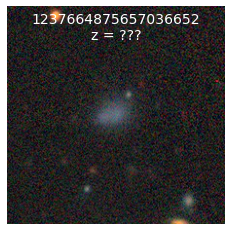

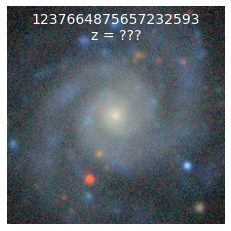

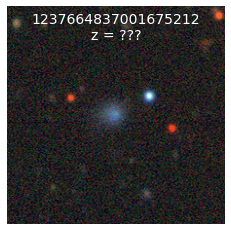

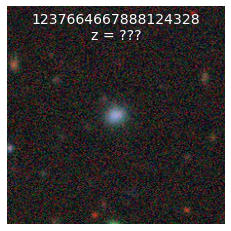

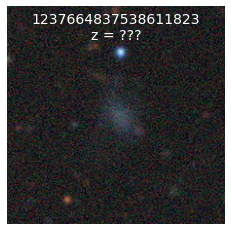

Host NSAID 332234 (6 sats)
RA, Dec = 218.93400, 35.07615
z = 0.028748


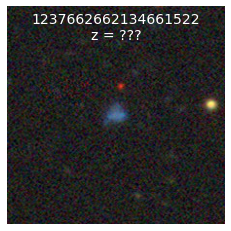

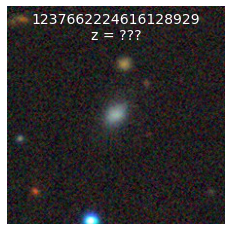

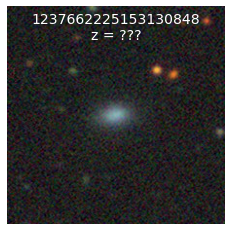

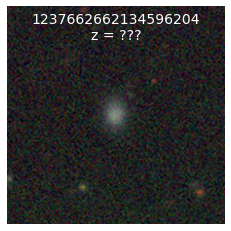

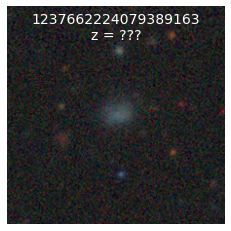

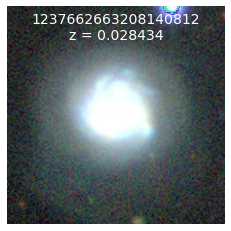

Host NSAID 589732 (1 sats)
RA, Dec = 125.89257, 21.34762
z = 0.017974


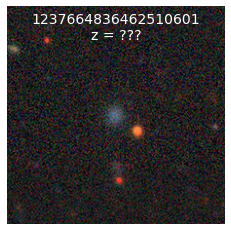

Host NSAID 630701 (21 sats)
RA, Dec = 207.71130, 39.57484
z = 0.008406


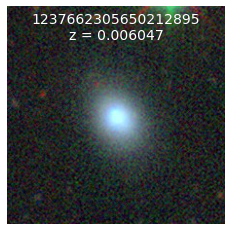

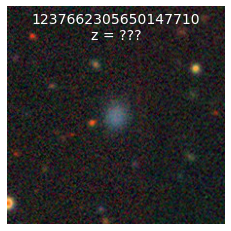

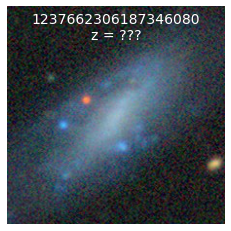

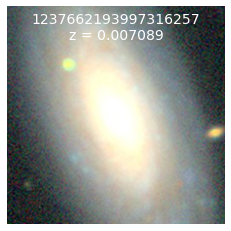

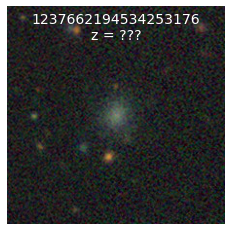

...

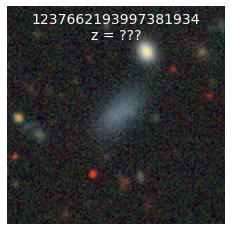

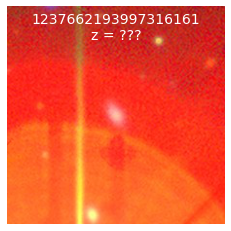

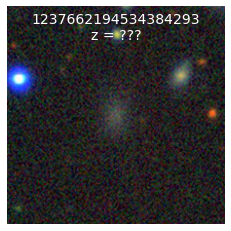

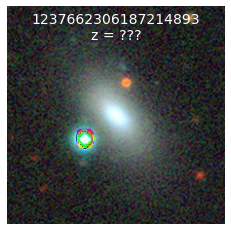

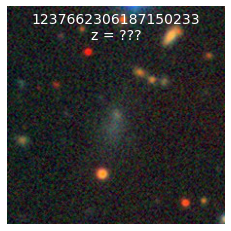

In [137]:
# $ wc -l groupby-NSA-host_-21_-20/*.csv | shuf -n 10
host_ids = [604842, 422659, 272662, 183336, 276483, 437905, 407998, 332234, 589732, 630701, ]
for host_id in host_ids:
    host = hosts.loc[host_id]
    RA, DEC = host.ra_NSA, host.dec_NSA
    
    sats_in_host = pd.read_csv(results_dir/f'groupby-NSA-host_-21_-20/{host_id}.csv')
    
    print(f'Host NSAID {host_id} ({len(sats_in_host):d} sats)\nRA, Dec = {RA:.5f}, {DEC:.5f}\nz = {host.z_NSA:.6f}')
    for sat in sats_in_host.itertuples():
        url = (
            "http://legacysurvey.org/viewer/cutout.jpg"
            f"?ra={sat.ra}"
            f"&dec={sat.dec}"
            "&layer=dr8"
            "&size=224"
        )

        response = requests.get(url, stream=True)
        img = Image.open(response.raw)

        plt.imshow(img)
        
        z_sat = f'{sat.z_NSA:.6f}' if sat.sep_NSA < 1 else '???'
        plt.text(0.5, 0.85, f'{sat.objID}\n' f'z = {z_sat}', color='white', ha='center', transform=plt.gca().transAxes, fontsize=14)
        plt.axis('off')
        plt.gca().set_aspect('equal')
        plt.show()

## Host mass vs number of satellites

The easiest way to do this is to start with the brightest/most massive hosts, search around 300 pkpc, find all satellites, make sure that no "satellite" is brighter/more massive than the host or within 300 pkpc of a previously found host, and then save the number of satellites.

In [136]:
sat_x_nsa = pd.read_csv(results_dir/'sat_x_NSA.csv')
sat_coords = SkyCoord(sat_coords.ra, sat_coords.dec, unit='deg')

In [152]:
nsa = load_NSA().set_index('NSAID')
nsa_coords = SkyCoord(nsa.ra_NSA, nsa.dec_NSA, unit='deg')

_, sep, _ = nsa_coords.match_to_catalog_sky(sat_coords)


In [148]:
nsa.columns

Index(['z_NSA', 'ra_NSA', 'dec_NSA', 'M_r_NSA', 'mass_NSA'], dtype='object')

In [157]:
hosts = nsa[sep < 1*u.deg].copy()
hosts = hosts[(hosts.mass_NSA < 1e14) & (hosts.mass_NSA > 1e8) & (hosts.z_NSA < 0.03)].copy()
len(hosts)

8102

In [160]:
hosts.sort_values('mass_NSA', ascending=False)

,z_NSA,ra_NSA,dec_NSA,M_r_NSA,mass_NSA
NSAID,,,,,
631731,0.028266,216.724452,46.614053,-23.743507,3.719392e+11
245896,0.022468,140.400391,34.351000,-25.992575,1.985357e+11
651237,0.023086,153.460518,38.764921,-22.426229,1.223512e+11
301345,0.029000,198.156642,47.063278,-22.313509,1.083099e+11
623200,0.023176,139.945261,33.749757,-22.120626,1.075657e+11
...,...,...,...,...,...
267156,0.006070,222.115187,38.875733,-15.122866,1.004216e+08
339744,0.013067,216.207944,47.418939,-15.376232,1.003630e+08
269383,0.014981,154.853383,42.932929,-15.936669,1.003035e+08


In [170]:
sat_x_nsa

,objID,ra,dec,g0,r0,R_eff,p_sat,sep_NSA,NSAID,z_NSA,ra_NSA,dec_NSA,M_r_NSA
0,1237658611977683171,158.800296,46.236739,16.74269,16.63662,4.760215,0.973726,0.156747,182632,0.001683,158.800279,46.236697,-13.112530
1,1237658205594255594,215.662531,46.523653,17.09699,16.75046,6.126145,0.956580,0.961786,249487,0.015607,215.662146,46.523622,-16.801690
2,1237662661594513672,210.489465,36.168611,17.54862,17.17523,3.863583,0.975288,3.308254,331199,0.017141,210.490307,36.169229,-16.834050
3,1237664853642641571,211.454811,34.821669,16.66302,16.30888,6.990974,0.975213,0.274055,393744,0.025648,211.454899,34.821645,-18.302956
4,1237664869753815354,151.808694,30.781045,20.51001,20.04107,2.715549,0.761499,682.554548,414418,0.021374,151.594510,30.826910,-18.264923
...,...,...,...,...,...,...,...,...,...,...,...,...,...
9226,1237657776619585730,141.516264,44.733895,17.66065,17.44162,3.946793,0.976916,0.376029,146037,0.010464,141.516375,44.733827,-15.296142
9227,1237659162809401767,236.425513,44.511237,18.03398,17.63797,5.081613,0.966708,1.018683,262310,0.019347,236.425909,44.511251,-16.329615
9228,1237661357540115170,170.692705,46.598638,19.04106,18.70818,3.597445,0.954951,458.006085,295154,0.017476,170.583304,46.701333,-18.293596
9229,1237657771243405446,139.907581,48.266706,15.79002,15.28462,6.289228,0.740016,1401.178661,164727,0.027257,140.461214,48.142835,-19.439669


In [177]:
set([1, 2, 3]).intersection([0, 5, 7, 1])

{1}

In [179]:
host_dict.keys()

dict_keys([])

In [188]:
host_sep

<Angle [29.73454639, 66.55188939, 69.07666243, ..., 37.86667565,
        17.47956058, 14.41194789] deg>

In [193]:
host_dict = dict()

for host in tqdm(hosts.itertuples(), total=len(hosts)):
    nsaid, z, ra, dec, M_r, mass = host
    
    host_coords = SkyCoord(ra, dec, unit='deg')
    host_sep = host_coords.separation(sat_coords)
    
    sats_in_host = sat_x_nsa[host_sep < 1*u.deg]

    # skip if already saved in dict
    if [i for i in sats_in_host.NSAID if i in host_dict.keys()]:
        continue
        
    n_sat_in_1deg = sum(host_sep < 1*u.deg)
    n_sat_in_300kpc = sum(host_sep < 1*u.deg * z / 0.015)
    
    host_dict[nsaid] = [ra, dec, z, M_r, mass, n_sat_in_1deg, n_sat_in_300kpc]

,0,1,2,3,4,5,6
46685,118.868868,39.420193,0.019848,-17.640957,6.553300e+08,1,4
47001,119.562303,44.437865,0.023016,-17.507801,5.859601e+08,1,4
47193,119.638013,45.329426,0.021892,-17.547153,1.244195e+09,1,6
47219,119.936129,45.366090,0.016251,-19.218748,7.115732e+09,1,2
47266,120.958533,41.712591,0.020765,-16.661280,3.405614e+08,5,15
...,...,...,...,...,...,...,...
683357,222.111531,34.998047,0.029420,-21.818520,6.057066e+10,8,33
685635,234.669252,41.005552,0.022596,-19.172670,2.178350e+09,9,42
685765,236.029129,47.294520,0.019862,-18.098726,1.491254e+09,5,13
685895,237.755719,23.015737,0.024888,-20.436470,2.126617e+10,5,10


In [202]:
host_df = pd.DataFrame.from_dict(
    host_dict, 
    orient='index', 
    columns=['ra', 'dec', 'z', 'M_r', 'mass', 'n_sat_in_1deg', 'n_sat_in_300kpc'],
)
host_df.index.name = 'NSAID'
host_df.sample(5, random_state=42)

,ra,dec,z,M_r,mass,n_sat_in_1deg,n_sat_in_300kpc
NSAID,,,,,,,
418326,199.762967,39.589330,0.023731,-20.692650,1.480914e+10,14,33
131957,141.386491,50.355968,0.025654,-17.401049,8.374653e+08,5,28
144975,126.743836,36.193614,0.028544,-17.035700,6.649660e+08,7,15
176105,144.028521,41.195343,0.027799,-19.774313,8.886991e+09,11,57
487538,125.943800,19.157074,0.026548,-17.422157,1.868776e+08,1,10


In [204]:
host_df.to_csv(results_dir/'hosts-no-overlap.csv', index=True)

Plot!

### Median and 68% interval

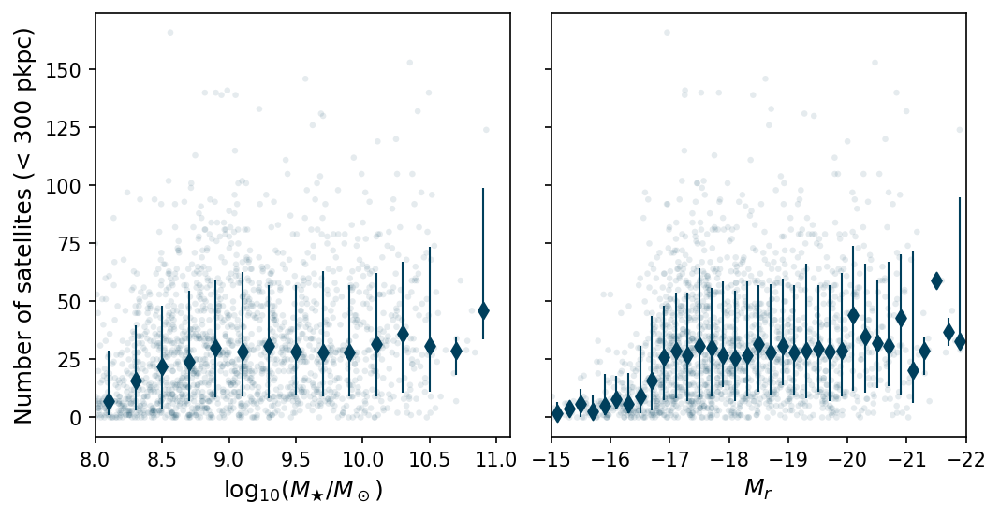

In [262]:
fig, [ax1, ax2] = plt.subplots(1, 2, figsize=(8, 4), dpi=150, sharey=True)

# plot stellar mass
ax1.scatter(host_df.mass.apply(np.log10), host_df.n_sat_in_300kpc, edgecolors='none', s=10, alpha=0.1, c=c0)

mass_bins = np.arange(8., 11.5, 0.2)
median_n_sat = [host_df.n_sat_in_300kpc[(host_df.mass > 10**m1) & (host_df.mass < 10**m2)].median() for m1, m2 in zip(mass_bins[:-1], mass_bins[1:])]
p68_n_sat = np.array([host_df.n_sat_in_300kpc[(host_df.mass > 10**m1) & (host_df.mass < 10**m2)].quantile([0.16, 0.84]) for m1, m2 in zip(mass_bins[:-1], mass_bins[1:])])

ax1.scatter(mass_bins[:-1]+0.1, median_n_sat, c=c0, marker='d')
ax1.vlines(mass_bins[:-1]+0.1, p68_n_sat[:,0], p68_n_sat[:, 1], colors=c0, lw=1)

ax1.set_xlim(8.0, 11.1)
ax1.set_xlabel(r'$\log_{10}(M_★/M_\odot)$', fontsize=12)
ax1.set_ylabel('Number of satellites (< 300 pkpc)', fontsize=12);

# plot abs mag
ax2.scatter(host_df.M_r, host_df.n_sat_in_300kpc, edgecolors='none', s=10, alpha=0.1, c=c0)

mag_bins = np.arange(-22, -14.8, 0.2)
median_n_sat = [host_df.n_sat_in_300kpc[(host_df.M_r > mag1) & (host_df.M_r < mag2)].median() for mag1, mag2 in zip(mag_bins[:-1], mag_bins[1:])]
p68_n_sat = np.array([host_df.n_sat_in_300kpc[(host_df.M_r > mag1) & (host_df.M_r < mag2)].quantile([0.16, 0.84]) for mag1, mag2 in zip(mag_bins[:-1], mag_bins[1:])])

ax2.scatter(mag_bins[:-1]+0.1, median_n_sat, c=c0, marker='d')
ax2.vlines(mag_bins[:-1]+0.1, p68_n_sat[:,0], p68_n_sat[:, 1], colors=c0, lw=1)

ax2.set_xlim(-15., -22)
ax2.set_xlabel(r'$M_{r}$', fontsize=12)

fig.subplots_adjust(wspace=0.1)



### Mean and standard deviation

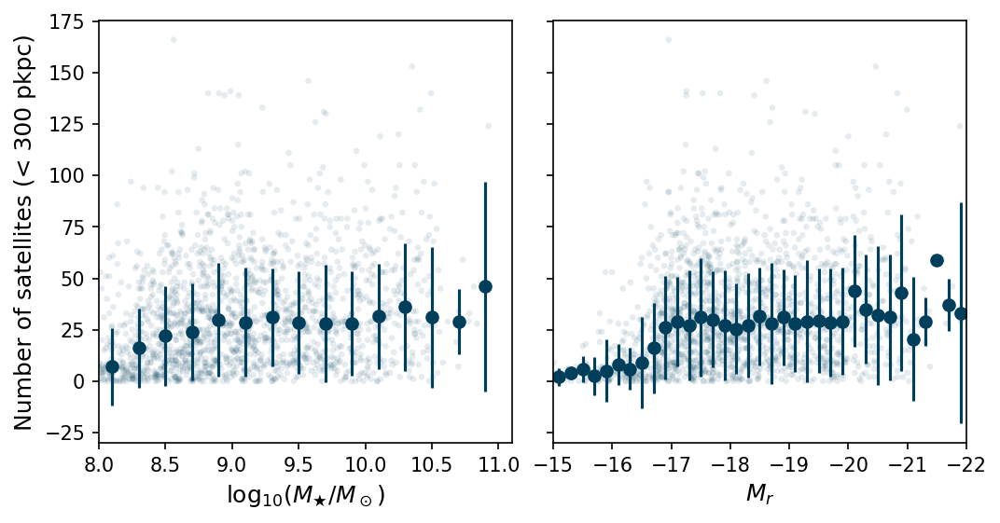

In [246]:
fig, [ax1, ax2] = plt.subplots(1, 2, figsize=(8, 4), dpi=150, sharey=True)

# plot stellar mass
ax1.scatter(host_df.mass.apply(np.log10), host_df.n_sat_in_300kpc, edgecolors='none', s=10, alpha=0.1, c=c0)

mass_bins = np.arange(8., 11.5, 0.2)
mean_n_sat = [host_df.n_sat_in_300kpc[(host_df.mass > 10**m1) & (host_df.mass < 10**m2)].mean() for m1, m2 in zip(mass_bins[:-1], mass_bins[1:])]
std_n_sat = np.array([host_df.n_sat_in_300kpc[(host_df.mass > 10**m1) & (host_df.mass < 10**m2)].std() for m1, m2 in zip(mass_bins[:-1], mass_bins[1:])])

ax1.errorbar(mass_bins[:-1]+0.1, mean_n_sat, std_n_sat, c=c0, marker='o', ls='')

ax1.set_xlim(8.0, 11.1)
ax1.set_xlabel(r'$\log_{10}(M_★/M_\odot)$', fontsize=12)
ax1.set_ylabel('Number of satellites (< 300 pkpc)', fontsize=12);

# plot abs mag
ax2.scatter(host_df.M_r, host_df.n_sat_in_300kpc, edgecolors='none', s=10, alpha=0.1, c=c0)

mag_bins = np.arange(-22, -14.8, 0.2)
mean_n_sat = [host_df.n_sat_in_300kpc[(host_df.M_r > mag1) & (host_df.M_r < mag2)].mean() for mag1, mag2 in zip(mag_bins[:-1], mag_bins[1:])]
std_n_sat = np.array([host_df.n_sat_in_300kpc[(host_df.M_r > mag1) & (host_df.M_r < mag2)].std() for mag1, mag2 in zip(mag_bins[:-1], mag_bins[1:])])

ax2.errorbar(mag_bins[:-1]+0.1, mean_n_sat, std_n_sat, c=c0, marker='o', ls='')

ax2.set_xlim(-15., -22)
ax2.set_xlabel(r'$M_{r}$', fontsize=12)

fig.subplots_adjust(wspace=0.1)



### Bootstrapped mean and standard error

In [263]:
from astropy.stats import bootstrap

In [272]:
error_n_sat[0]

array([21.26008372, 18.05326249, 17.57119773, 17.30091429, 21.54556922,
       17.72000644, 19.68542908, 17.0685799 , 17.78422808, 18.88362309,
       18.01302684, 15.4304851 , 18.63852065, 19.71874426, 18.00163099,
       19.0307761 , 19.7298822 , 21.06715878, 19.50062431, 19.20838981,
       20.63383401, 16.36816015, 18.80746693, 17.96197019, 19.95183291,
       18.27625066, 18.06046361, 19.96990668, 19.84636636, 18.05713405,
       16.584784  , 17.93674639, 18.71629776, 19.50743081, 19.39772164,
       17.79829599, 19.04696223, 19.5452024 , 19.03642054, 18.49801849,
       20.38613027, 21.51296827, 19.58559877, 16.48938175, 15.12250942,
       17.35863165, 19.48753603, 17.99801849, 20.30765599, 21.21598832,
       21.49962693, 21.36539515, 20.55344686, 17.0915214 , 18.84537471,
       19.75680521, 19.09540539, 19.84725624, 15.5737609 , 19.986683  ,
       16.96295847, 19.35680426, 18.24497977, 18.82545631, 15.52099335,
       18.20114145, 20.40126445, 19.43782074, 19.89658621, 20.28

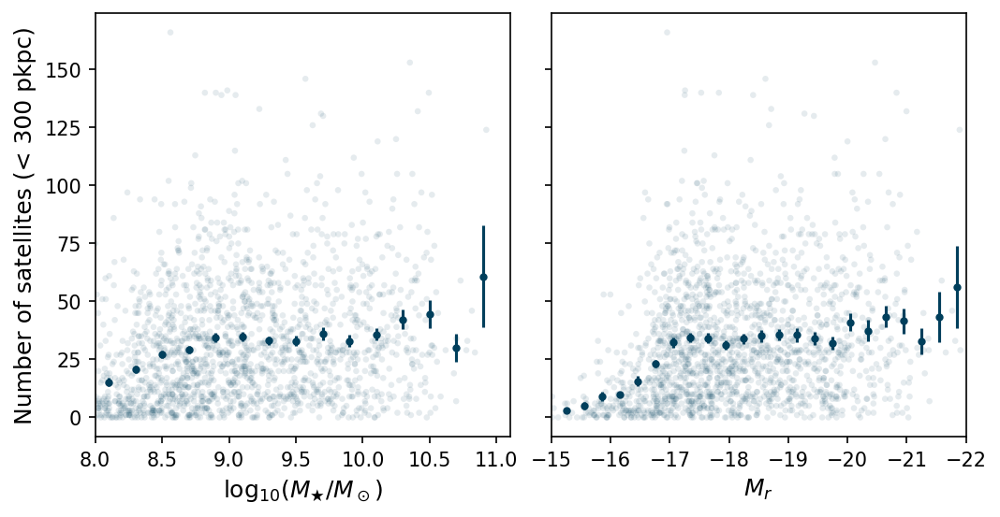

In [308]:
fig, [ax1, ax2] = plt.subplots(1, 2, figsize=(8, 4), dpi=150, sharey=True)

# plot stellar mass
ax1.scatter(host_df.mass.apply(np.log10), host_df.n_sat_in_300kpc, edgecolors='none', s=10, alpha=0.1, c=c0)

mass_bins = np.arange(8., 11.2, 0.2)
boot_n_sat = np.array([
    bootstrap(
        host_df.n_sat_in_300kpc[(host_df.mass > 10**m1) & (host_df.mass < 10**m2)].values,
        bootfunc=np.mean,
    ) for m1, m2 in zip(mass_bins[:-1], mass_bins[1:])]
)

ax1.errorbar(mass_bins[:-1]+0.1, boot_n_sat.mean(1), boot_n_sat.std(1), c=c0, marker='o', ls='', markersize=3)

ax1.set_xlim(8.0, 11.1)
ax1.set_xlabel(r'$\log_{10}(M_★/M_\odot)$', fontsize=12)
ax1.set_ylabel('Number of satellites (< 300 pkpc)', fontsize=12);

# plot abs mag
ax2.scatter(host_df.M_r, host_df.n_sat_in_300kpc, edgecolors='none', s=10, alpha=0.1, c=c0)

mag_bins = np.arange(-22., -15, 0.3)
boot_n_sat = np.array([
    bootstrap(
        host_df.n_sat_in_300kpc[(host_df.M_r > mag1) & (host_df.M_r < mag2)].values,
        bootfunc=np.mean,
    ) for mag1, mag2 in zip(mag_bins[:-1], mag_bins[1:])]
)
ax2.errorbar(mag_bins[:-1]+0.15, boot_n_sat.mean(1), boot_n_sat.std(1), c=c0, marker='o', ls='', markersize=3)

ax2.set_xlim(-15., -22)
ax2.set_xlabel(r'$M_{r}$', fontsize=12)

fig.subplots_adjust(wspace=0.1)

